In [3]:
pip uninstall face_recognition

Found existing installation: face-recognition 1.3.0
Uninstalling face-recognition-1.3.0:
  Would remove:
    /Users/ethanchen/opt/anaconda3/bin/face_detection
    /Users/ethanchen/opt/anaconda3/bin/face_recognition
    /Users/ethanchen/opt/anaconda3/lib/python3.7/site-packages/face_recognition-1.3.0.dist-info/*
    /Users/ethanchen/opt/anaconda3/lib/python3.7/site-packages/face_recognition/*
Proceed (y/n)? ^C
ERROR: Operation cancelled by user
Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install face_recognition

  Using cached face_recognition-1.3.0-py2.py3-none-any.whl (15 kB)
Note: you may need to restart the kernel to use updated packages.


In [4]:
import PIL
from PIL import Image, ImageChops, ImageFilter
from PIL import ImageDraw
import numpy as np
import os
import sys
import re
import pandas as pd
import datetime

from datetime import datetime
import face_recognition
import sklearn
from sklearn import svm


print('Successful Installation')


ImportError: cannot import name 'issparse' from 'scipy.sparse' (unknown location)

## Gathering and Identifying Face Locations

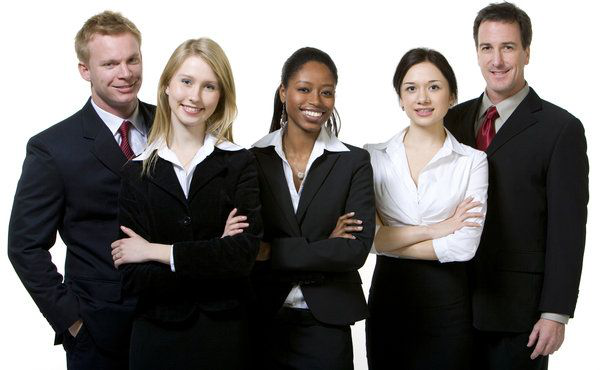

In [49]:
image = Image.open("Week2/stock_people.jpg")
image

In [50]:
filename = "Week2/stock_people.jpg"
stock_people = face_recognition.load_image_file(filename)

In [51]:
stock_people

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [254, 254, 254],
        [254, 254, 254],
        [254, 254, 254]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [254, 254, 254],
        [254, 254, 254],
        [254, 254, 254]]

In [52]:
face_locations = face_recognition.face_locations(stock_people)
print('Face Locations:', face_locations)
print("I found {} face(s) in this photograph.".format(len(face_locations)))

Face Locations: [(72, 446, 124, 394), (32, 529, 94, 467), (72, 337, 124, 285), (72, 222, 124, 170), (39, 149, 101, 87)]
I found 5 face(s) in this photograph.


## Applications of Face Locations

**1. Identifying Face Locations**

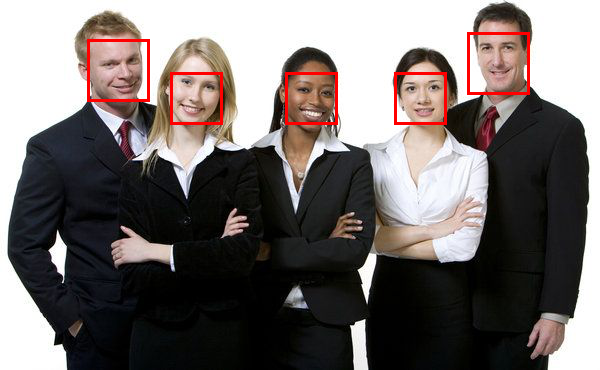

In [53]:

# We copy the image since we don't want to draw on the original image.
img_copy = image.copy()

draw = ImageDraw.Draw(img_copy)
for location in face_locations:
    top, right, bottom, left = location
    draw.rectangle(((left, top), (right, bottom)), outline=(255, 0, 0), width=3)
del(draw)
img_copy

**2. Blurring Faces**

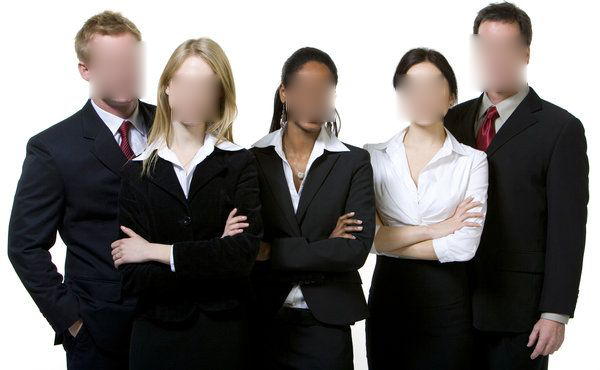

In [54]:
img_copy = image.copy()

for location in face_locations:
    top, right, bottom, left = location
    crop = (left, top, right, bottom)
    buffer_crop = img_copy.crop(crop)
    # blur multiple times for a bolder blur
    for _ in range(30):
        buffer_crop = buffer_crop.filter(ImageFilter.BLUR)
    img_copy.paste(buffer_crop, crop)
img_copy

**3 Face Landmarks**

In [55]:
face_landmarks_list = face_recognition.face_landmarks(stock_people)
face_landmarks_list

[{'chin': [(400, 91),
   (401, 97),
   (402, 102),
   (404, 108),
   (406, 113),
   (409, 117),
   (413, 122),
   (418, 125),
   (424, 126),
   (430, 125),
   (436, 123),
   (441, 119),
   (445, 114),
   (448, 109),
   (449, 102),
   (449, 96),
   (450, 90)],
  'left_eyebrow': [(403, 85), (405, 82), (409, 81), (413, 81), (416, 83)],
  'right_eyebrow': [(426, 82), (430, 80), (435, 79), (439, 80), (443, 82)],
  'nose_bridge': [(421, 88), (422, 92), (422, 96), (422, 100)],
  'nose_tip': [(417, 103), (420, 104), (422, 105), (425, 104), (427, 103)],
  'left_eye': [(407, 89),
   (410, 87),
   (413, 87),
   (416, 90),
   (413, 90),
   (410, 90)],
  'right_eye': [(429, 89),
   (431, 86),
   (435, 86),
   (437, 88),
   (435, 89),
   (432, 89)],
  'top_lip': [(414, 110),
   (417, 108),
   (420, 107),
   (423, 108),
   (426, 107),
   (430, 108),
   (434, 109),
   (433, 110),
   (426, 109),
   (423, 109),
   (420, 109),
   (415, 110)],
  'bottom_lip': [(434, 109),
   (431, 113),
   (427, 115),
   

I found 5 face(s) in this photograph.
The chin in this face has the following points: [(400, 91), (401, 97), (402, 102), (404, 108), (406, 113), (409, 117), (413, 122), (418, 125), (424, 126), (430, 125), (436, 123), (441, 119), (445, 114), (448, 109), (449, 102), (449, 96), (450, 90)]
The left_eyebrow in this face has the following points: [(403, 85), (405, 82), (409, 81), (413, 81), (416, 83)]
The right_eyebrow in this face has the following points: [(426, 82), (430, 80), (435, 79), (439, 80), (443, 82)]
The nose_bridge in this face has the following points: [(421, 88), (422, 92), (422, 96), (422, 100)]
The nose_tip in this face has the following points: [(417, 103), (420, 104), (422, 105), (425, 104), (427, 103)]
The left_eye in this face has the following points: [(407, 89), (410, 87), (413, 87), (416, 90), (413, 90), (410, 90)]
The right_eye in this face has the following points: [(429, 89), (431, 86), (435, 86), (437, 88), (435, 89), (432, 89)]
The top_lip in this face has the fo

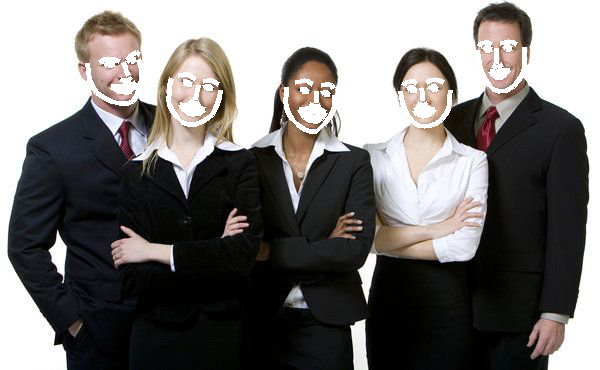

In [16]:
image = stock_people

# Find all facial features in all the faces in the image
face_landmarks_list = face_recognition.face_landmarks(image)

print("I found {} face(s) in this photograph.".format(len(face_landmarks_list)))

# Create a PIL imagedraw object so we can draw on the picture
pil_image = Image.fromarray(image)
d = ImageDraw.Draw(pil_image)

for face_landmarks in face_landmarks_list:

    # Print the location of each facial feature in this image
    for facial_feature in face_landmarks.keys():
        print("The {} in this face has the following points: {}".format(facial_feature, face_landmarks[facial_feature]))

    # Let's trace out each facial feature in the image with a line!
    for facial_feature in face_landmarks.keys():
        d.line(face_landmarks[facial_feature], width=5)

# Show the picture
pil_image

**4. Digital Makeup**

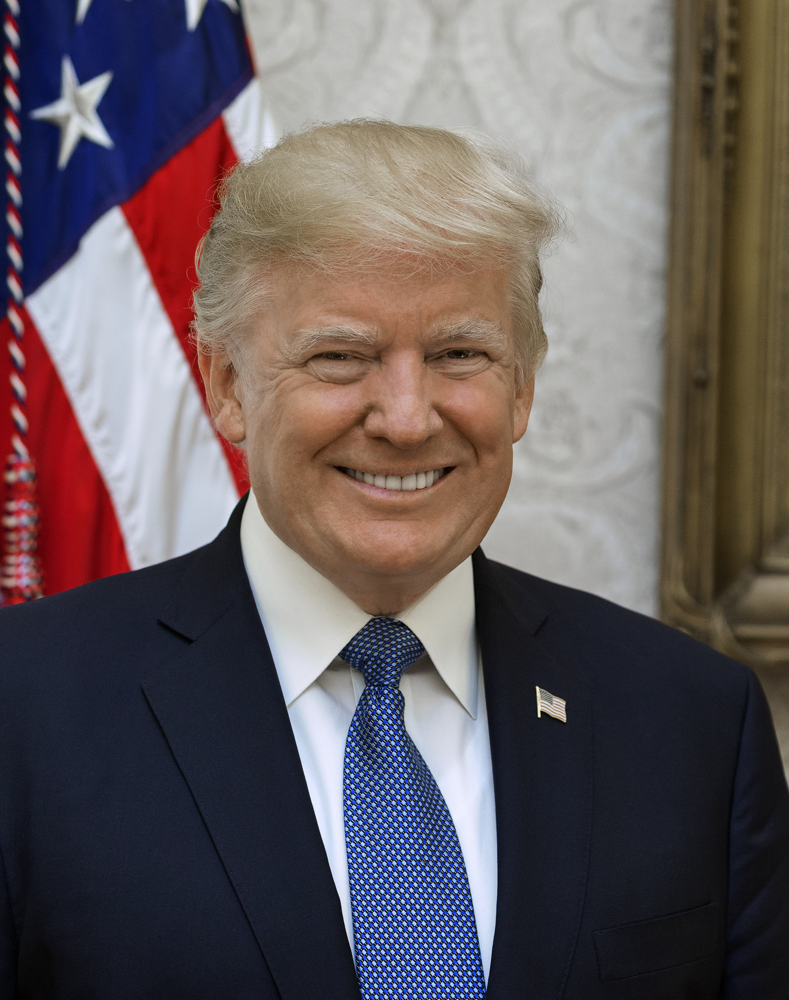

In [56]:
trump = face_recognition.load_image_file("Week2/trump.jpg")
Image.open("Week2/trump.jpg")

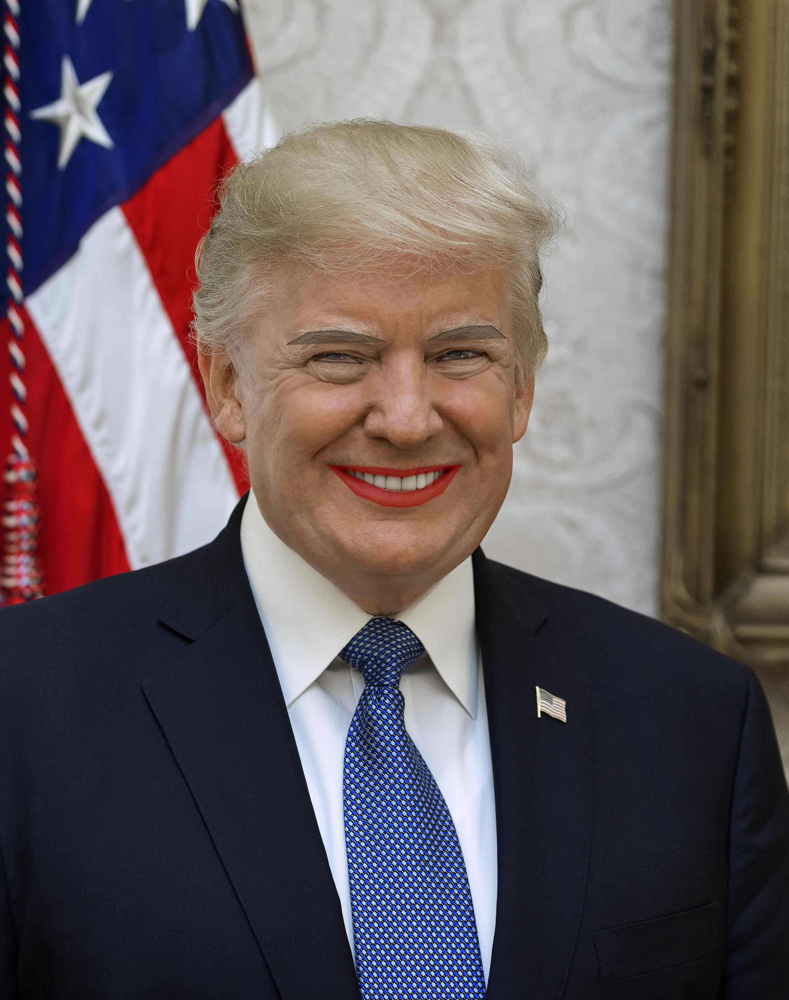

In [57]:
image = trump

# Find all facial features in all the faces in the image
face_landmarks_list = face_recognition.face_landmarks(image)

pil_image = Image.fromarray(image)
for face_landmarks in face_landmarks_list:
    d = ImageDraw.Draw(pil_image, 'RGBA')

    # Make the eyebrows into a nightmare
    d.polygon(face_landmarks['left_eyebrow'], fill=(68, 54, 39, 128))
    d.polygon(face_landmarks['right_eyebrow'], fill=(68, 54, 39, 128))
    d.line(face_landmarks['left_eyebrow'], fill=(68, 54, 39, 150), width=5)
    d.line(face_landmarks['right_eyebrow'], fill=(68, 54, 39, 150), width=5)

    # Gloss the lips
    d.polygon(face_landmarks['top_lip'], fill=(150, 0, 0, 128))
    d.polygon(face_landmarks['bottom_lip'], fill=(150, 0, 0, 128))
    d.line(face_landmarks['top_lip'], fill=(150, 0, 0, 64), width=8)
    d.line(face_landmarks['bottom_lip'], fill=(150, 0, 0, 64), width=8)

    # Sparkle the eyes
    d.polygon(face_landmarks['left_eye'], fill=(255, 255, 255, 30))
    d.polygon(face_landmarks['right_eye'], fill=(255, 255, 255, 30))

    # Apply some eyeliner
    d.line(face_landmarks['left_eye'] + [face_landmarks['left_eye'][0]], fill=(0, 0, 0, 110), width=6)
    d.line(face_landmarks['right_eye'] + [face_landmarks['right_eye'][0]], fill=(0, 0, 0, 110), width=6)

pil_image

# Comparing Faces/Associating Faces with Names


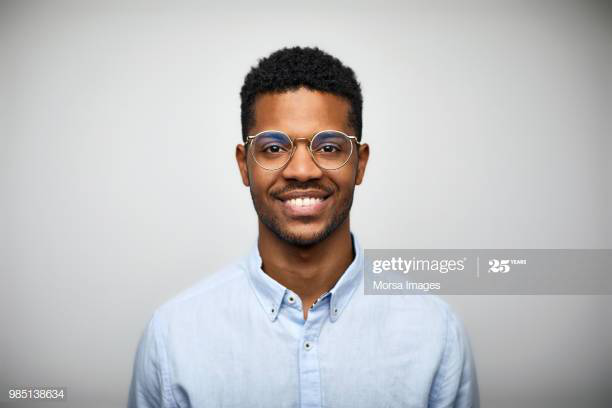

In [58]:
unknown = face_recognition.load_image_file("Week2/unknown.jpg")
Image.open('Week2/unknown.jpg')

In [59]:
known_image = trump
unknown_image = unknown

biden_encoding = face_recognition.face_encodings(known_image)[0]
unknown_encoding = face_recognition.face_encodings(unknown_image)[0]

results = face_recognition.compare_faces([biden_encoding], unknown_encoding)
if results == [False]:
    print('The unknown image IS NOT TRUMP')
else:
    print('The unknown image IS TRUMP')

The unknown image IS NOT TRUMP


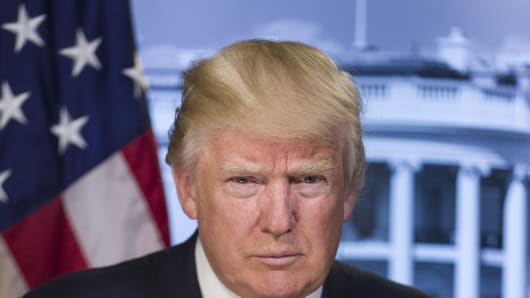

In [60]:
another_trump = face_recognition.load_image_file("Week2/another_trump.jpg")
Image.open('Week2/another_trump.jpg')

In [61]:
known_image = trump
unknown_image = another_trump

biden_encoding = face_recognition.face_encodings(known_image)[0]
unknown_encoding = face_recognition.face_encodings(unknown_image)[0]

results = face_recognition.compare_faces([biden_encoding], unknown_encoding)
if results == [False]:
    print('The unknown image IS NOT TRUMP')
else:
    print('The unknown image IS TRUMP')

The unknown image IS TRUMP


## Face Differences

Let's Let Python Play the Spot the Difference Game !

In [62]:
img1 = Image.open('Week2/1.jpg')
img2 = Image.open('Week2/2.jpg')


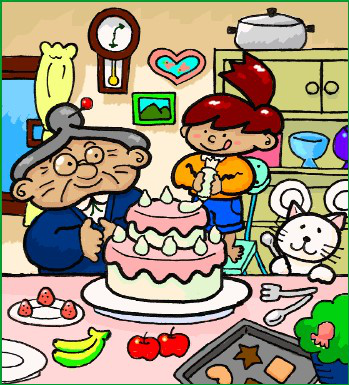

In [63]:
img1

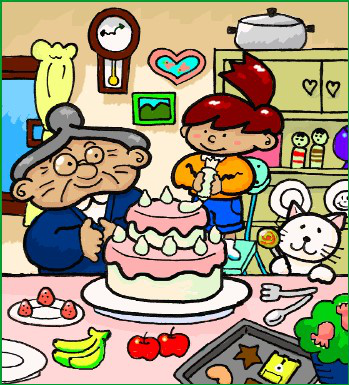

In [64]:
img2

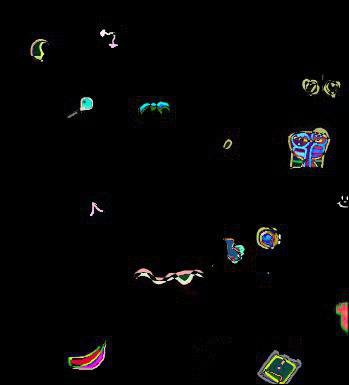

In [65]:
diff = ImageChops.difference(img1, img2)
diff.save('Week2/newdiff.jpg')
Image.open('Week2/newdiff.jpg')

**Image differencing is an easy way to help detect still faces from moving ones! For example, in a still image, the expected difference of that image taken at two different times is expected to be 0 (still_image - still_image)**

**For a moving image, however, any slight offset of pixels at two different times will result in a non-zero difference. Now we have a way to detect moving images with no need for video capture !**

## Faces to Names

**Instructions**

1) Create a directory called known_people (in your working directory)

    a) Fill the directory with pictures of people you want the facial recognition system to be trained with
    
    b) Name the files (Firstname Lastname.jpg)
 
2) Create a directory called unknown_people (in your working directory)

    a) Fill the directory with pictures of people you want the facial recognition system to identify
    
    b) Name the files (*any name of choice*.jpg)
    
3) On your terminal type the following:
    
    face_recognition known_people unknown_people
    
    We can know get a comma separated output of the faces the system recognized in our unknown_people folder !
    

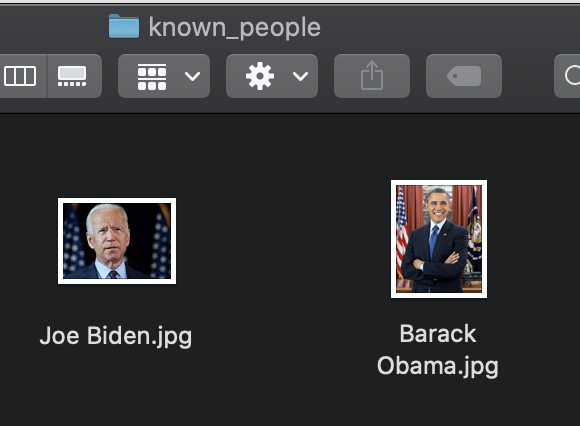

In [66]:
Image.open('Week2/known_dir.jpg')

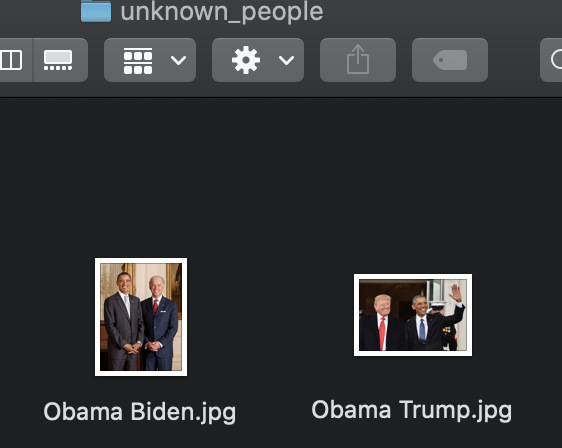

In [67]:
Image.open('Week2/unknown_dir.jpg')

**To start a terminal, use the "%%bash" command**

In [77]:
%%bash 
cd Week2
face_recognition known_people unknown_people

unknown_people/Obama Trump.jpg,unknown_person
unknown_people/Obama Trump.jpg,Barack Obama
unknown_people/Obama Biden.jpg,Barack Obama
unknown_people/Obama Biden.jpg,Joe Biden
